<a href="https://colab.research.google.com/github/akaver/ML/blob/master/building_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Clone cleaned dataset (train/test) from git.<br>
Test: One huge image (Tallinn) and 400 1000x1000 pieces from Estonian land authority. Some of these are hand annotated.
<br/>
Ca 2600 annotated sattelite images from xview2. Unlcleaned dataset for training is from:
https://xview2.org/challenge
Post catastrophe images from original dataset have been removed.<br>
Dataset is huge, ca 5 gb. It takes a long (15 min) time to download.

In [1]:
!rm -rf satellite
!git clone https://git.akaver.com/ml-datasets/satellite.git

Cloning into 'satellite'...
remote: Enumerating objects: 6049, done.
remote: Counting objects: 100% (6049/6049), done.
remote: Compressing objects: 100% (5513/5513), done.
remote: Total 6049 (delta 533), reused 5996 (delta 531)
Receiving objects: 100% (6049/6049), 4.93 GiB | 3.59 MiB/s, done.
Resolving deltas: 100% (533/533), done.
Checking out files: 100% (6007/6007), done.


In [28]:
# hm, cannot pull changes git? only clone?

git: 'sync' is not a git command. See 'git --help'.


Install latest torch, torchvision

In [2]:
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.3.1)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.4.2)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.14)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-5109voyw
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-5109voyw
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-ee7cqrzo
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-ee7cqrzo
     |████████████████████████████████| 266kB 5.1MB/s 
  Created wheel for fvcore: filename=fvcore-0.1-cp36-none-any.whl size=50315 sha256=ea46f89e5057c9982f3fc6fb24bc42d8d0f8f7106a26f1a05622bc6ae1a03800
  Stored in directory: /tmp/pip-ephem-wheel-cache-8sc8qq7d/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel f

'1.3.1'

Detectron installation complains about imgaug compatibility. You can try to downgrade it. But seems to work with newer version also.

In [3]:
!pip install imgaug==0.2.6

     |████████████████████████████████| 634kB 3.5MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=c014c384cf36303970abd720e983fa60e274dc4686ed5a319b319c20cc823414
  Stored in directory: /root/.cache/pip/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9


Install detectron2. Takes some time, wait for completion (Running setup.py develop for detectron2 - ca 5 min).
Restart colab runtime after installation.
Check, that your runtime is using GPU (Runtime>Change runtime type>Hardware accelerator>GPU).

In [4]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 69, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (50/50), done.
remote: Total 1610 (delta 22), reused 41 (delta 19), pack-reused 1541
Receiving objects: 100% (1610/1610), 1.70 MiB | 13.51 MiB/s, done.
Resolving deltas: 100% (966/966), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 2.1MB 3.5MB/s 
     |████████████████████████████████| 61kB 7.9MB/s 
  Found existing installation: Pillow 4.3.0
    Uninstalling Pillow-4.3.0:
      Successfully uninstalled Pillow-4.3.0
  Found existing installation: tqdm 4.28.1
    Uninstalling tqdm-4.28.1:
      Successfully uninstalled tqdm-4.28.1
  Running setup.py develop for detectron2


All the imports

In [0]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
import glob
import os
import json

from google.colab.patches import cv2_imshow # use if working with Google Colab

# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer

from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode
from detectron2.structures import BoxMode
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.engine import DefaultTrainer


**Method to prepare data in Detectron2 dataloader format - this is for xview2 images/annotations**

In [0]:
def get_dataset_dicts_xview(base_path):
    dataset_dicts = []
    filenames = glob.glob(os.path.join(base_path, "labels/*_pre_disaster.json"))

    for json_filename in random.sample(filenames, 150):
    #for json_filename in filenames:
        _, f_name = os.path.split(json_filename)
        img_filename = os.path.join(base_path, "images/" + f_name).replace(".json", ".png")

        record = {}

        height, width = cv2.imread(img_filename).shape[:2]

        record["file_name"] = img_filename
        record["height"] = height
        record["width"] = width

        objs = []
        #load image annotations
        with open(json_filename) as f:
            img_annotation = json.load(f)

        # iterate over image coordinate based features - buildings
        for x in img_annotation["features"]["xy"]:
            if x["properties"]["feature_type"] == "building":
                pts = np.empty([0, 2], np.int32)

                polygon_coords_str =  x["wkt"][10:-2]
                for polygon_coord in polygon_coords_str.split(","):
                    coords = polygon_coord.strip().split(" ")
                    x = int(coords[0].split(".")[0])
                    y = int(coords[1].split(".")[0])
                    pts = np.append(pts, [x, y])

                pts = pts.reshape((-1, 2))
                obj = {
                    # bounding box around the building
                    "bbox": [np.min(pts[:, 0]), np.min(pts[:, 1]), np.max(pts[:, 0]), np.max(pts[:, 1])],
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation": [],
                    "category_id": 0,
                    "iscrowd": 0
                }
                pts = pts.reshape((-1))
                # polygon around the building edges
                obj["segmentation"] = [pts.tolist()]
                objs.append(obj)

        record["annotations"] = objs
        dataset_dicts.append(record)

    return dataset_dicts

Set up DatasetCatalog and MetadataCatalog for XView. These is used by Detectron during training to load data.

In [0]:
DatasetCatalog.clear()
for d in ["train", "test"]:
    DatasetCatalog.register("xview/" + d, lambda d=d: get_dataset_dicts_xview("satellite/data/train"))
    MetadataCatalog.get("xview/" + d).set(thing_classes=["building"])
building_metadata = MetadataCatalog.get("xview/train")


Look at random XView test image, are bouding boxes and building outlines ok?

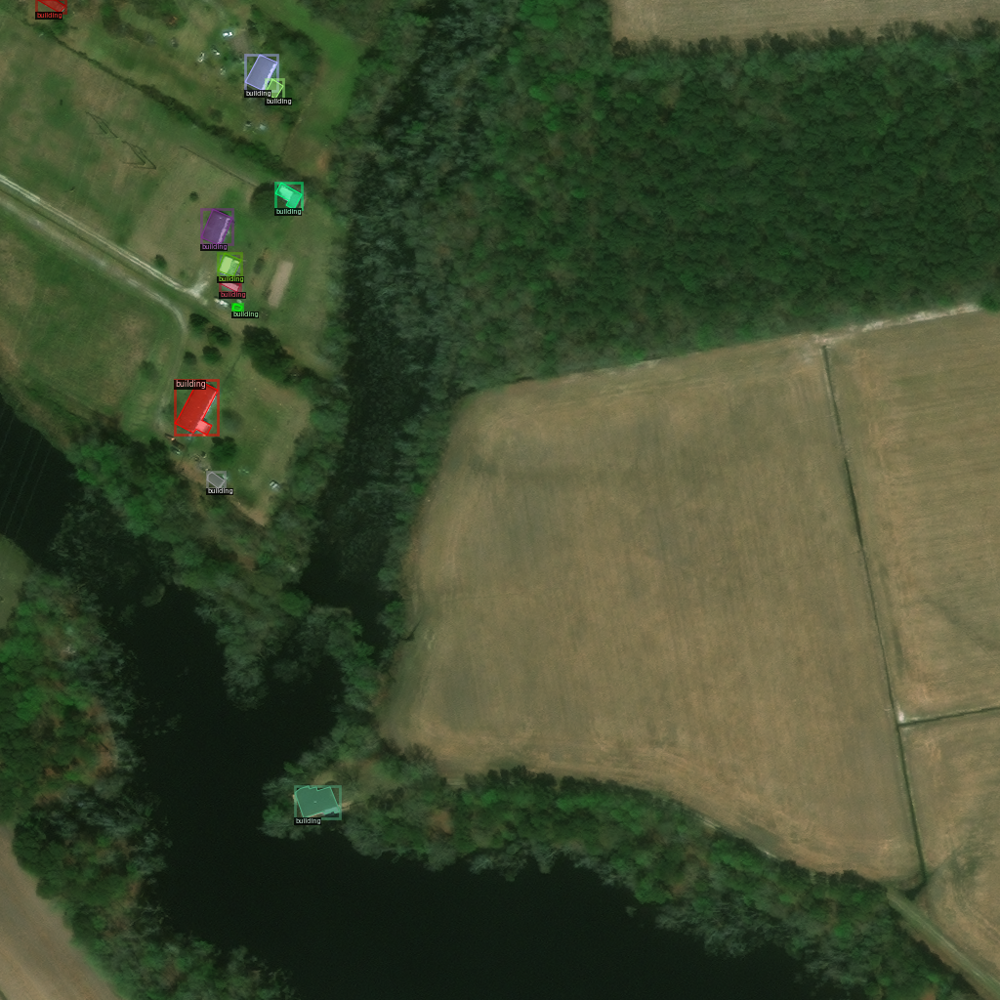

In [51]:
dataset = get_dataset_dicts_xview("satellite/data/train")
for d in random.sample(dataset, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=building_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

**Method to prepare data in Detectron2 dataloader format - this is for Estonian images**

In [0]:
def get_dataset_dicts_est(img_dir):
    json_file = os.path.join(img_dir, "annotations.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []

    images_dict = {}

    for v in imgs_anns["images"]:
        record = {}
        record["file_name"] = os.path.join(img_dir + "/test/", v["file_name"])

        """
        full_file_name = os.path.join(img_dir + "/test/", v["file_name"])
        height, width = cv2.imread(full_file_name).shape[:2]

        record["height"] = height
        record["width"] = width
        """
        record["height"] = 1000
        record["width"] = 1000
        record["annotations"] = []

        images_dict[v["id"]] = record


    for v in imgs_anns["annotations"]:

        image_id = v["image_id"]

        obj = {
            "bbox": v["bbox"],
            "bbox_mode": BoxMode.XYXY_ABS,
            "segmentation": v["segmentation"],
            "category_id": 0,
            "iscrowd": 0
        }

        # path is not closed, add starting x,y at the end also
        obj["segmentation"][0].append(obj["segmentation"][0][0])
        obj["segmentation"][0].append(obj["segmentation"][0][1])
        v["bbox"][2] = v["bbox"][0] + v["bbox"][2] - 1
        v["bbox"][3] = v["bbox"][1] + v["bbox"][3] - 1

        images_dict[image_id]["annotations"].append(obj)

    # add only images vith annotations to final dictionary
    for v in images_dict:
        if len(images_dict[v]["annotations"]) > 0:
            dataset_dicts.append(images_dict[v])

    return dataset_dicts


DatasetCatalog.clear()
from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "val"]:
    DatasetCatalog.register("est/" + d, lambda d=d: get_dataset_dicts_est("satellite/data"))
    # MetadataCatalog.get("est/" + d).set(thing_classes=["building"])
building_metadata = MetadataCatalog.get("est/train")

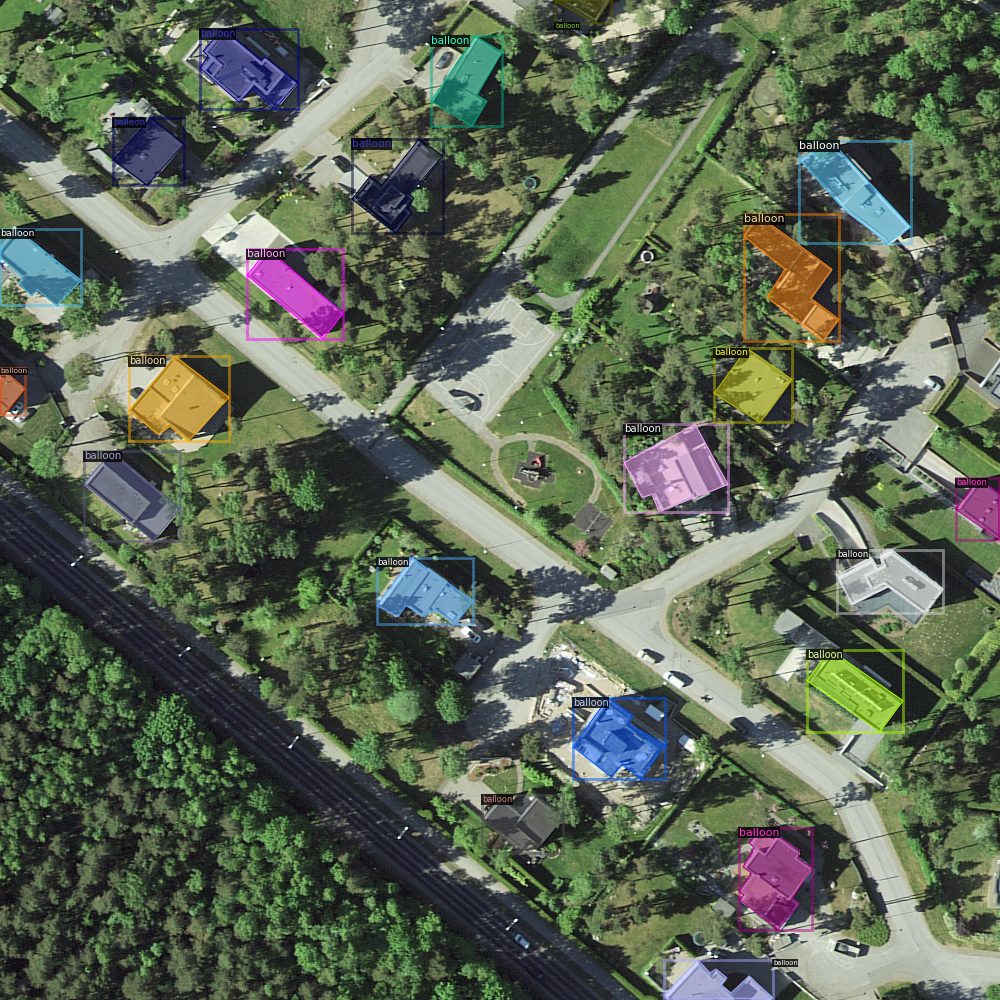

In [13]:
dataset = get_dataset_dicts_est("satellite/data/")
for d in random.sample(dataset, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=building_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

Set up training parameters and run training.
Play with BASE_LR and MAX_ITER

In [34]:
cfg = get_cfg()

#cfg.MODEL.DEVICE = "cpu"

cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.DATASETS.TRAIN = ("est/train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
#cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # 128 - faster, and good enough for this  dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (building)


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


WARNING [12/03 12:56:48 d2.config.compat]: Config './detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
[12/03 12:56:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
    

[12/03 12:56:50 d2.engine.train_loop]: Starting training from iteration 0
[12/03 12:57:11 d2.utils.events]: eta: 0:05:00  iter: 19  total_loss: 2.028  loss_cls: 0.575  loss_box_reg: 0.235  loss_mask: 0.693  loss_rpn_cls: 0.334  loss_rpn_loc: 0.083  time: 1.0578  data_time: 0.0039  lr: 0.000050  max_mem: 6979M
[12/03 12:57:31 d2.utils.events]: eta: 0:04:31  iter: 39  total_loss: 1.986  loss_cls: 0.472  loss_box_reg: 0.507  loss_mask: 0.661  loss_rpn_cls: 0.250  loss_rpn_loc: 0.085  time: 1.0442  data_time: 0.0042  lr: 0.000100  max_mem: 6979M
[12/03 12:57:54 d2.utils.events]: eta: 0:04:17  iter: 59  total_loss: 1.955  loss_cls: 0.422  loss_box_reg: 0.608  loss_mask: 0.605  loss_rpn_cls: 0.167  loss_rpn_loc: 0.079  time: 1.0718  data_time: 0.0039  lr: 0.000150  max_mem: 6979M
[12/03 12:58:16 d2.utils.events]: eta: 0:03:59  iter: 79  total_loss: 1.804  loss_cls: 0.392  loss_box_reg: 0.734  loss_mask: 0.512  loss_rpn_cls: 0.114  loss_rpn_loc: 0.066  time: 1.0873  data_time: 0.0043  lr: 0.0

OrderedDict()

In [0]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Make predictions on random training images. Just for fun.

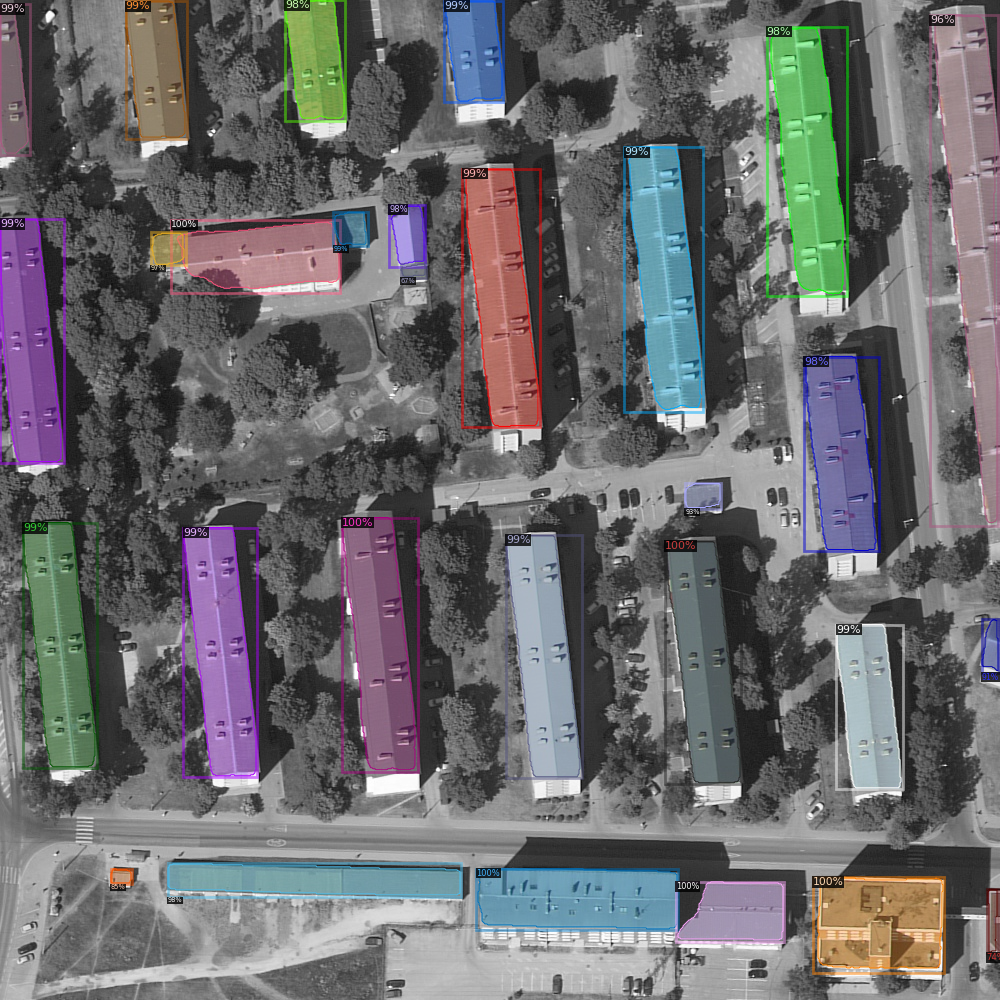

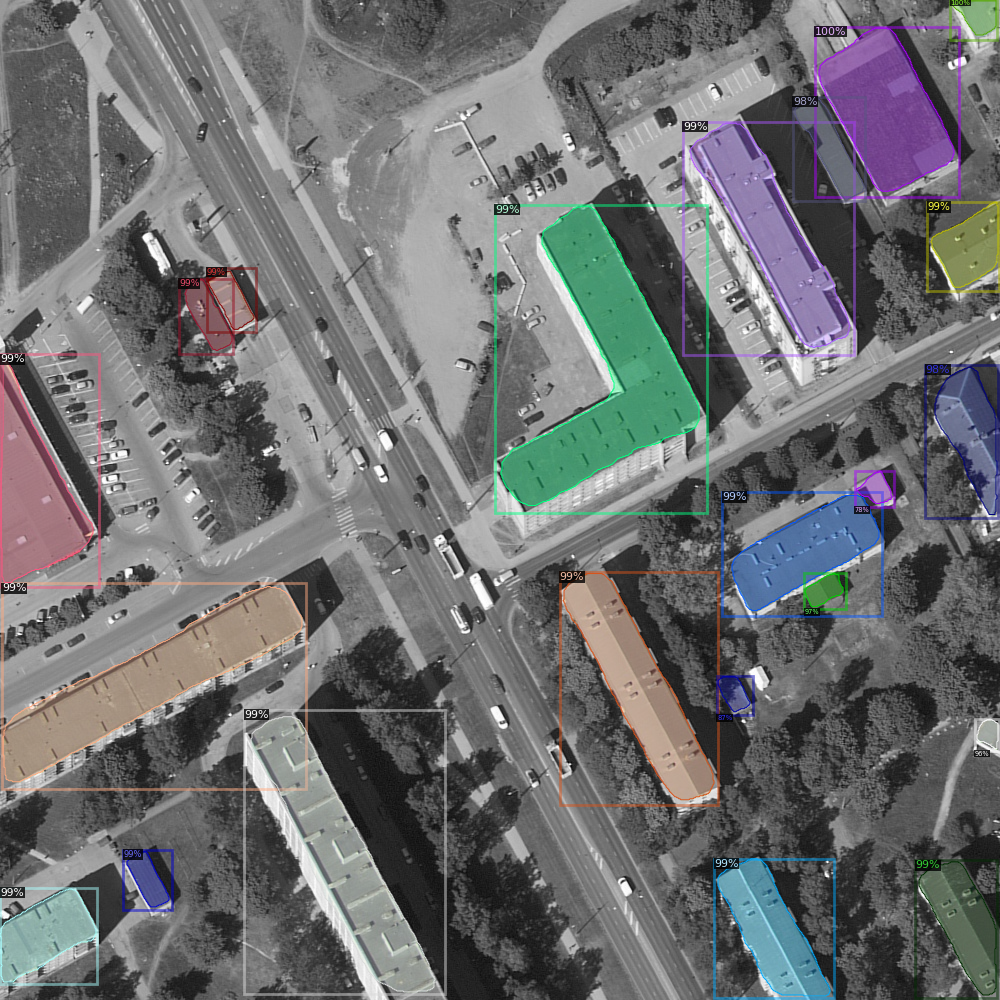

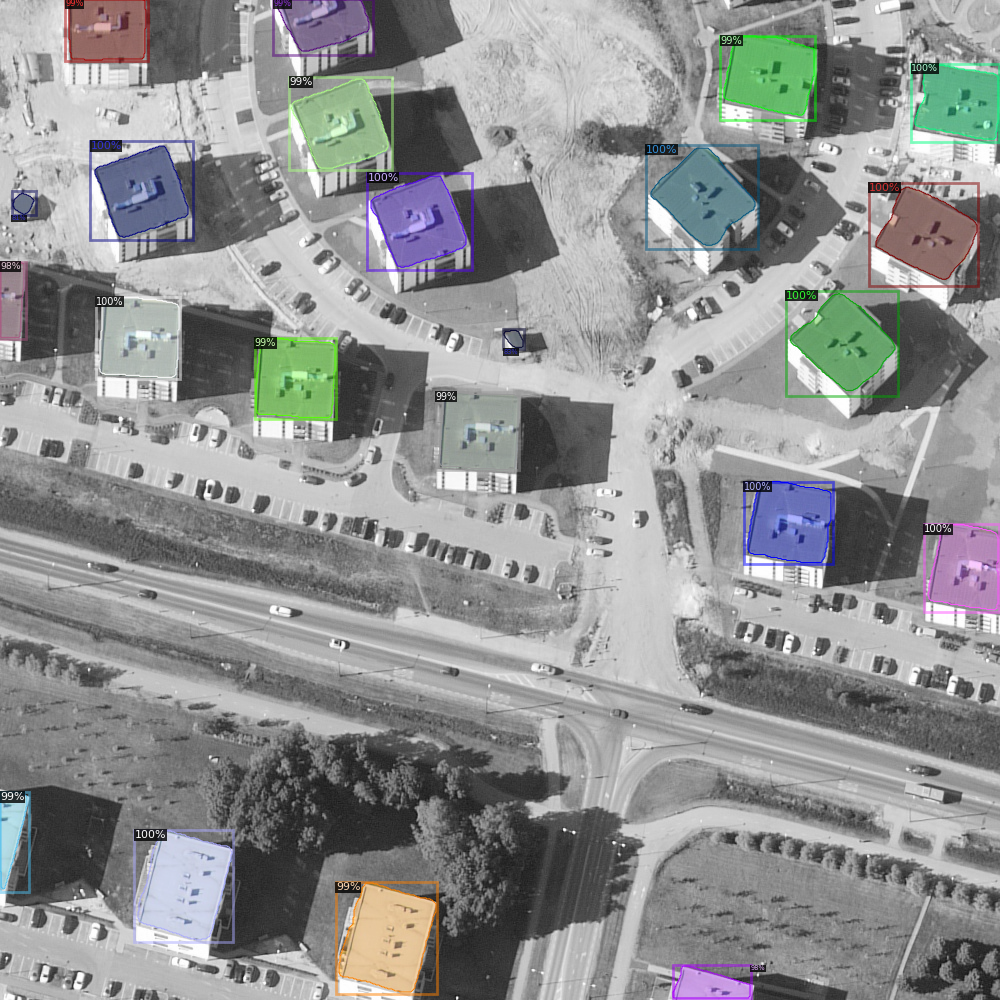

In [25]:
# load weights
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set the testing threshold for this model
# Set training data-set path
cfg.DATASETS.TEST = ("est/train", )
# Create predictor (model for inference)
predictor = DefaultPredictor(cfg)

dataset_dicts = get_dataset_dicts_est("satellite/data/")
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=building_metadata,
                   scale=1.0,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

Make predictions on Tallinn/Estonia ortophoto. This is 20 000x20 000 image.
Cut out 1024*1024 pieces randomly.

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
# Set training data-set path
cfg.DATASETS.TEST = ("satellite/building/val", )
# Create predictor (model for inference)
predictor = DefaultPredictor(cfg)

# load the BIG image
img = cv2.imread("satellite/data/63834.tif", cv2.IMREAD_ANYCOLOR)


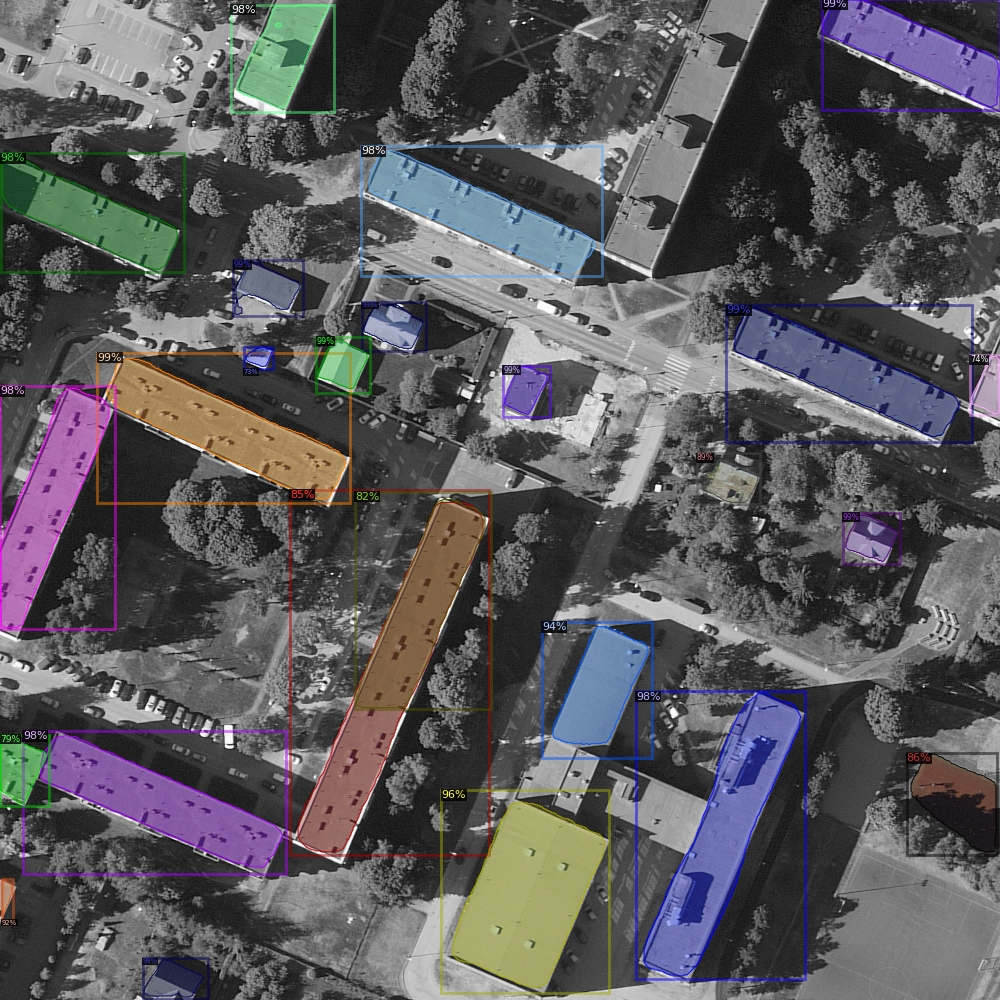

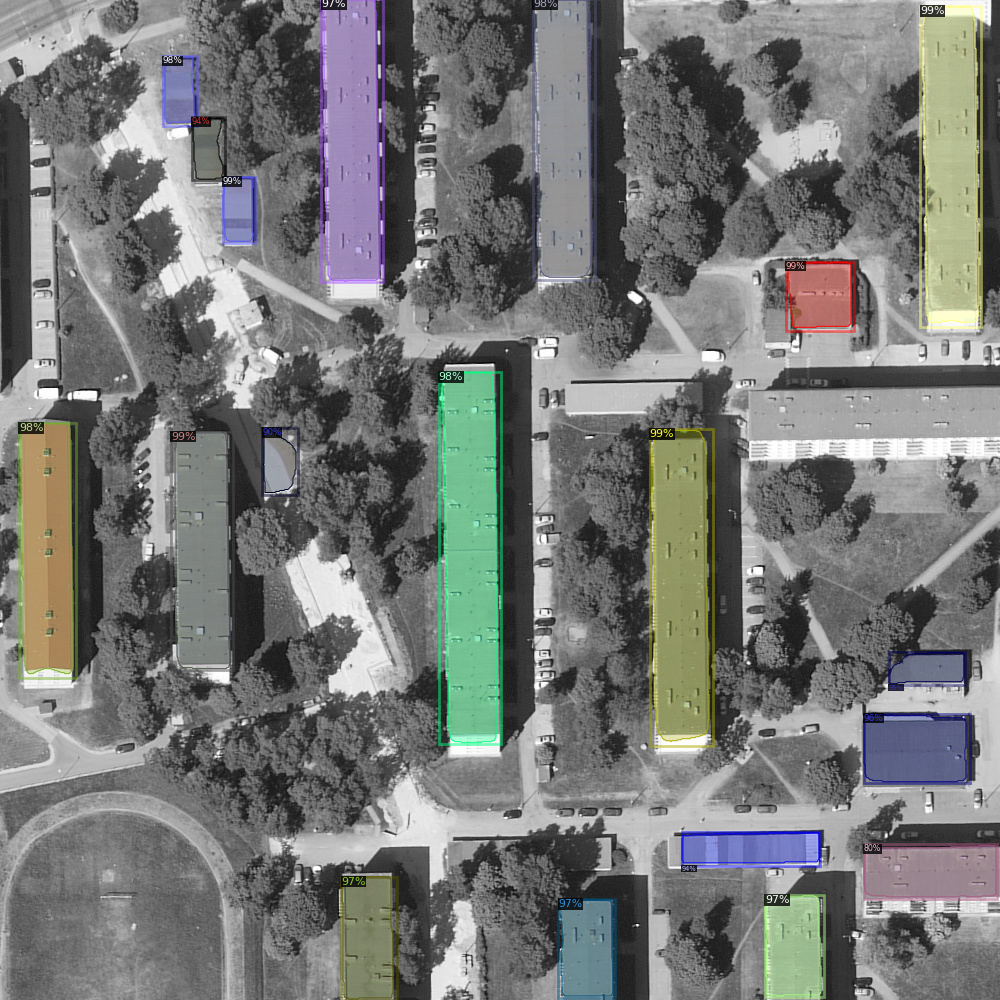

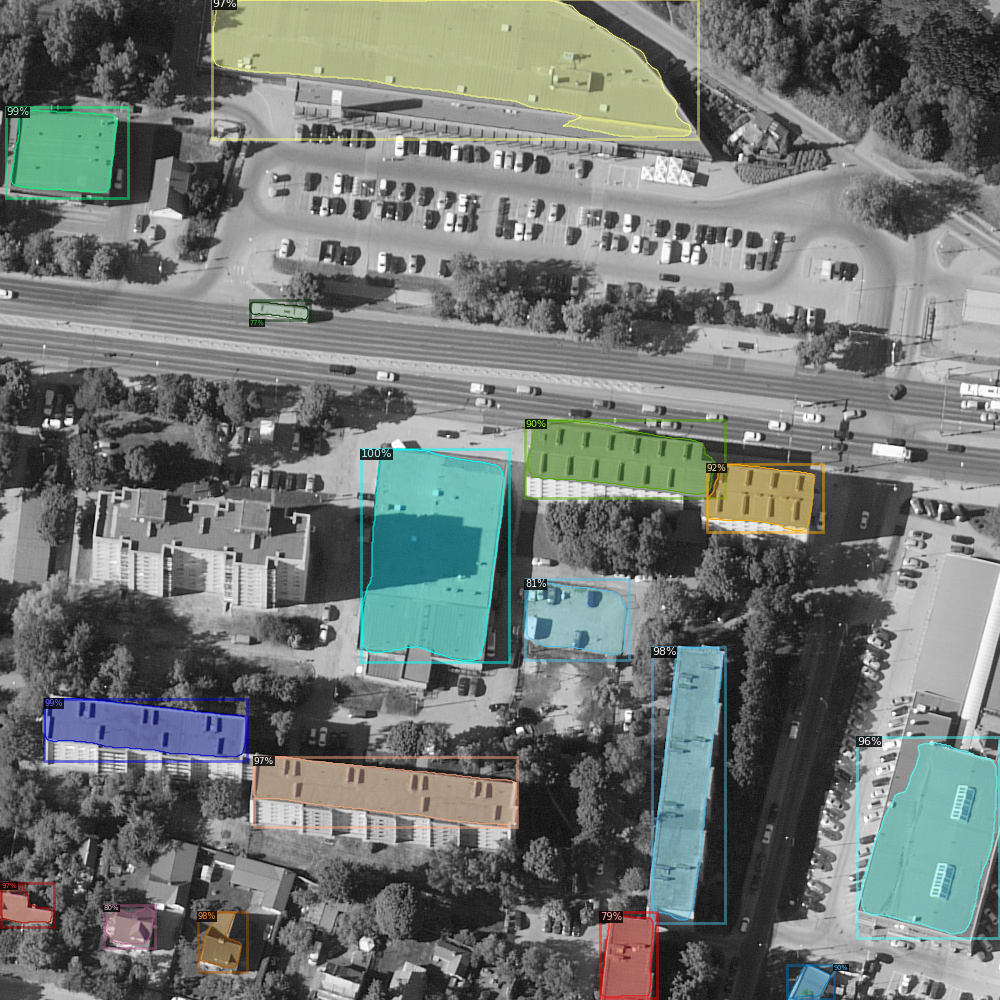

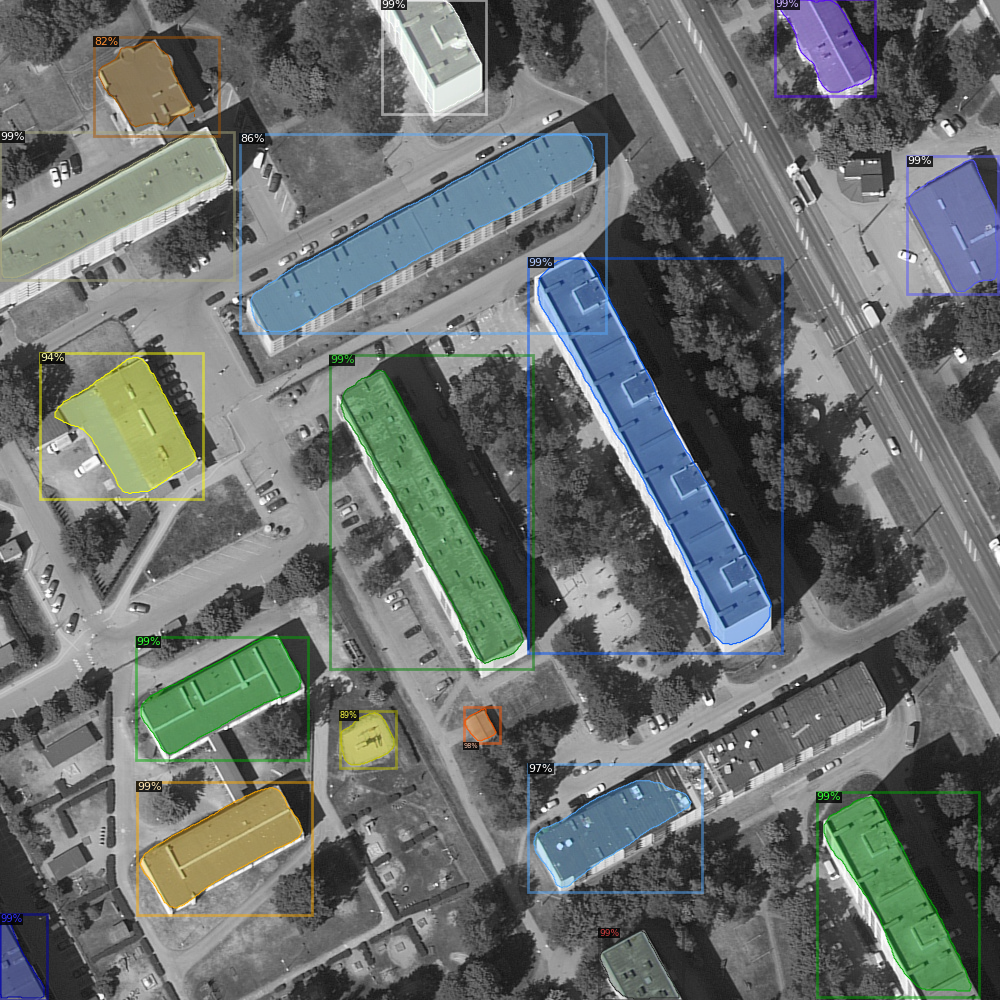

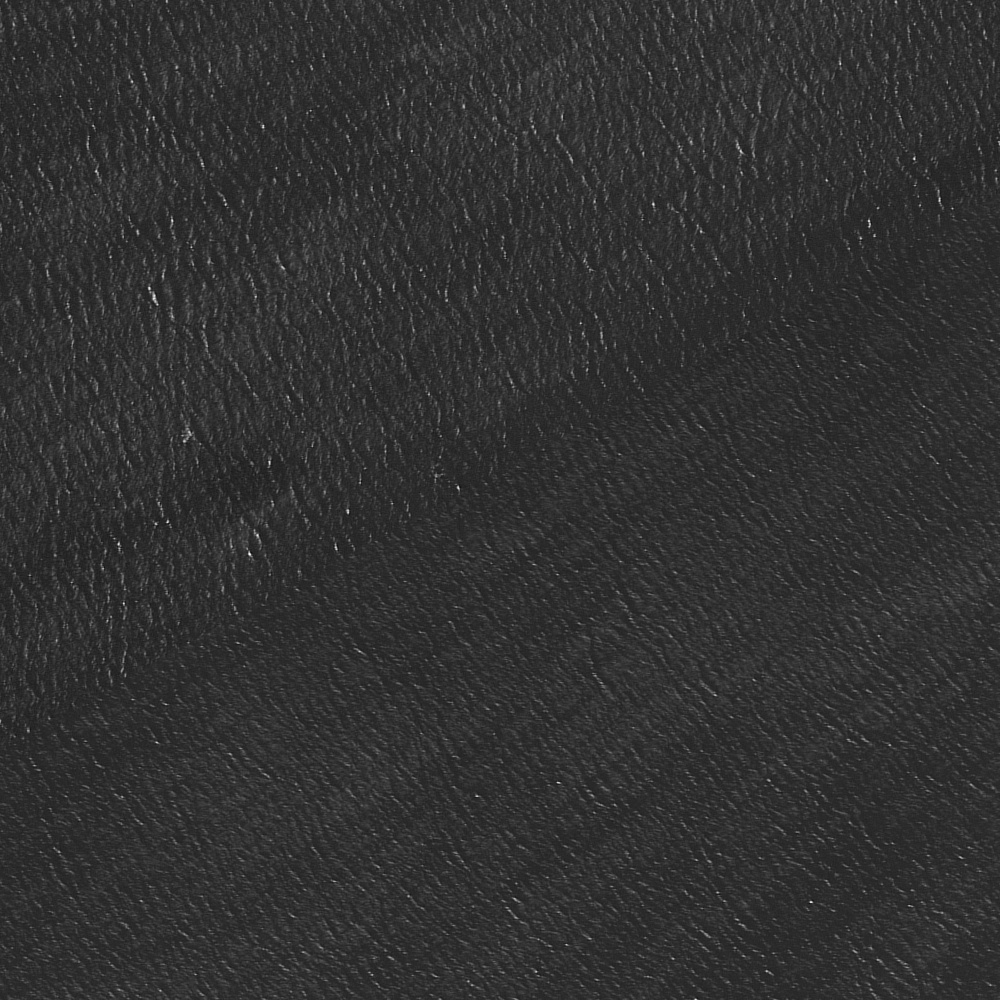

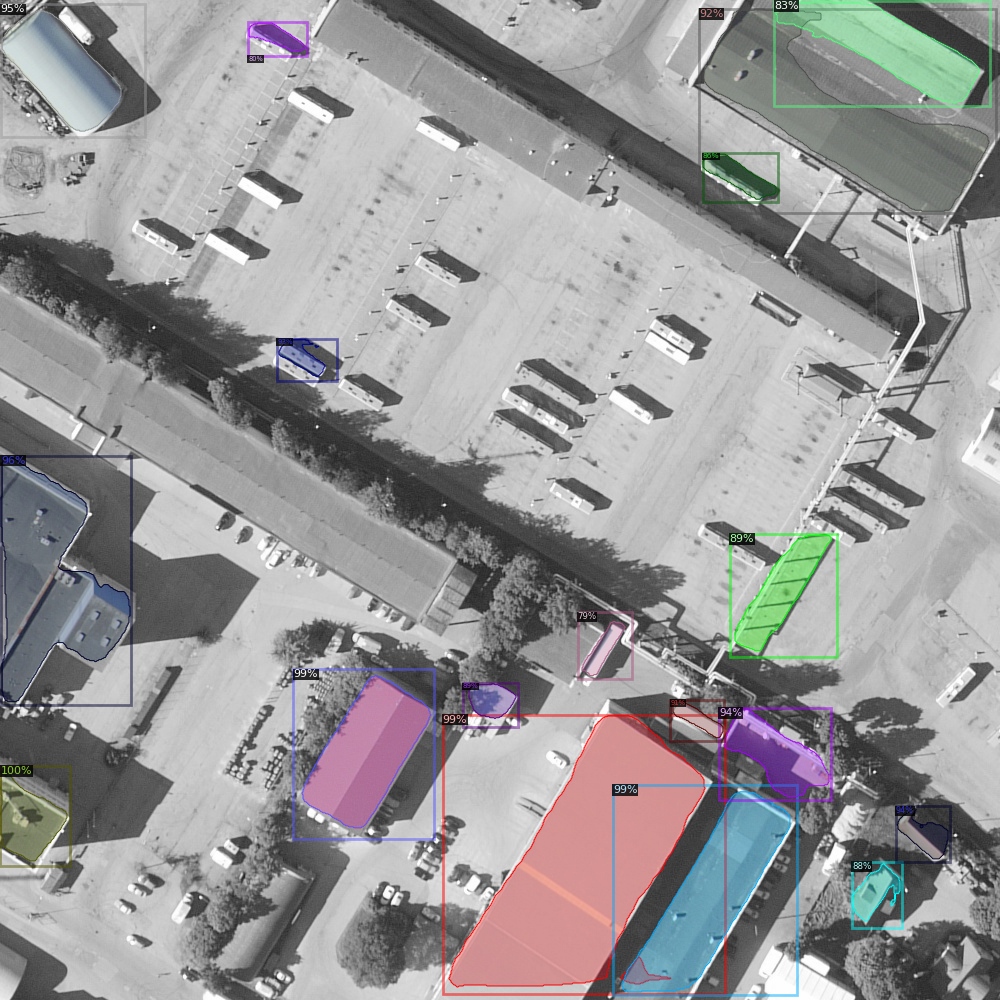

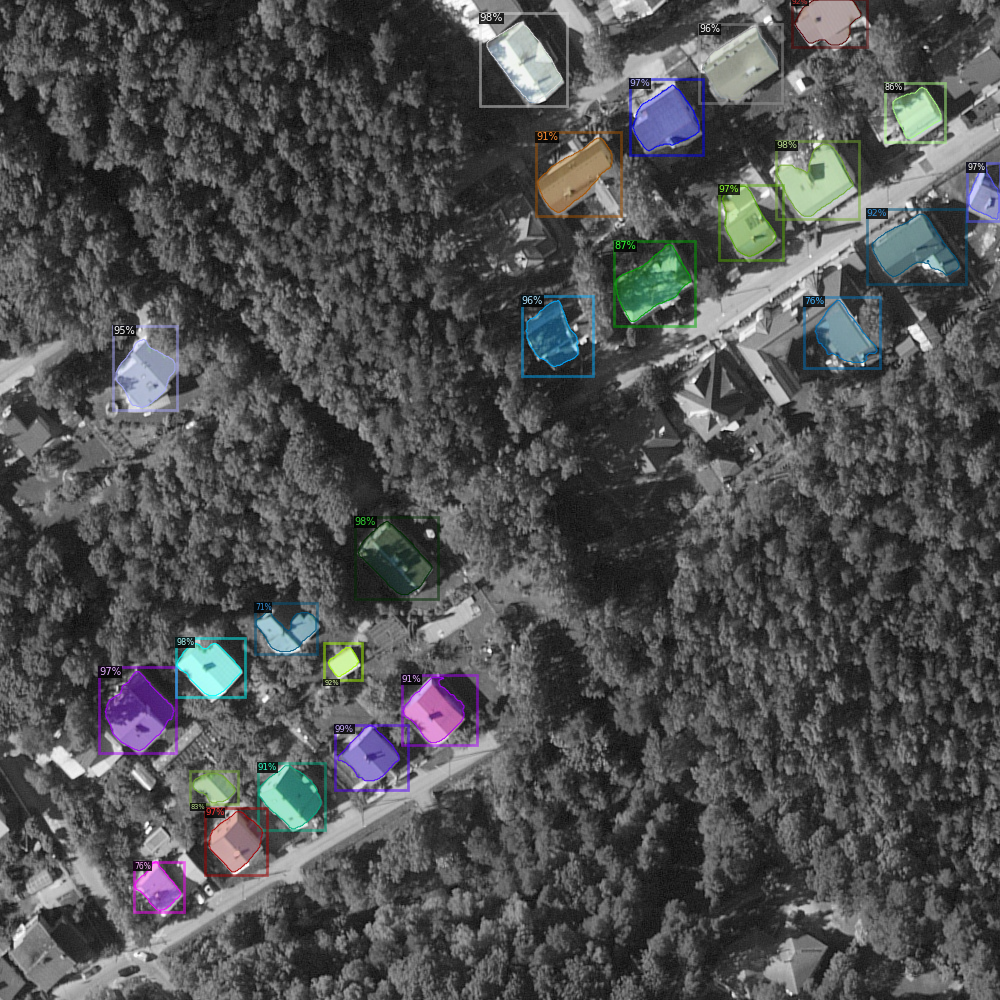

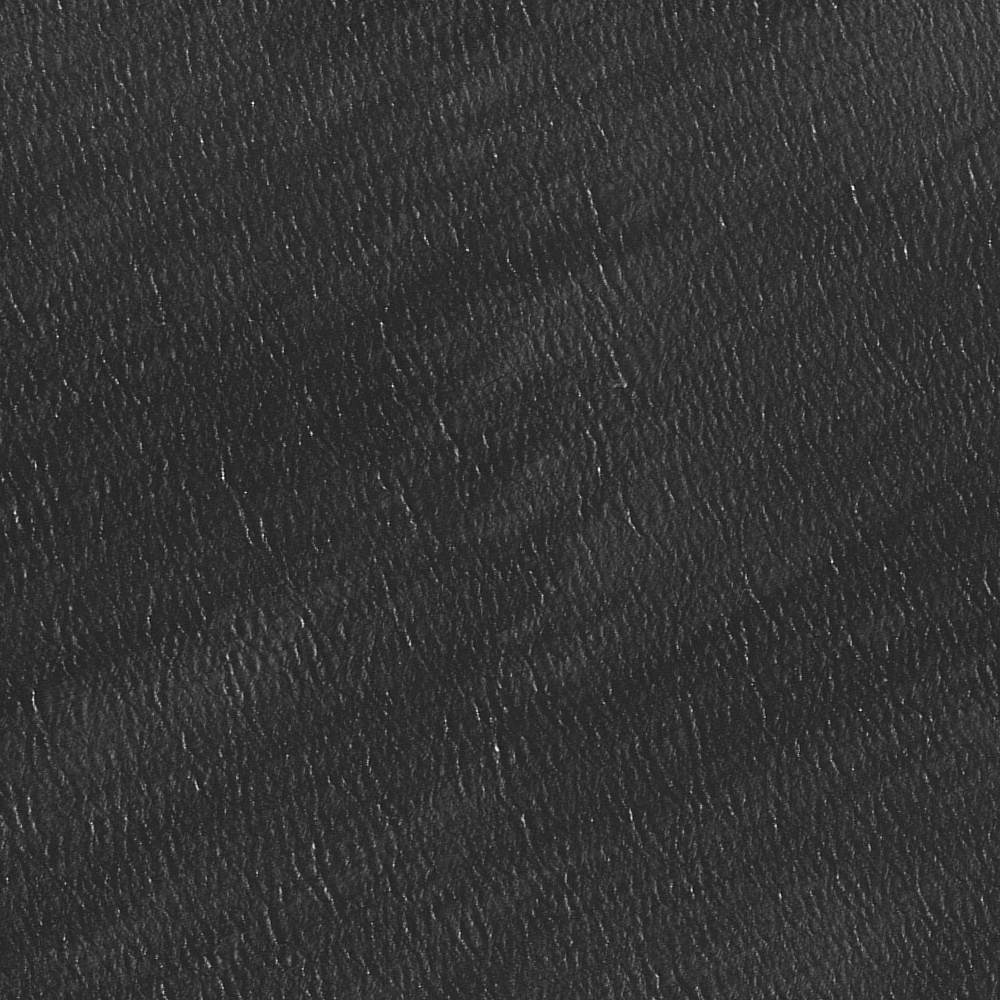

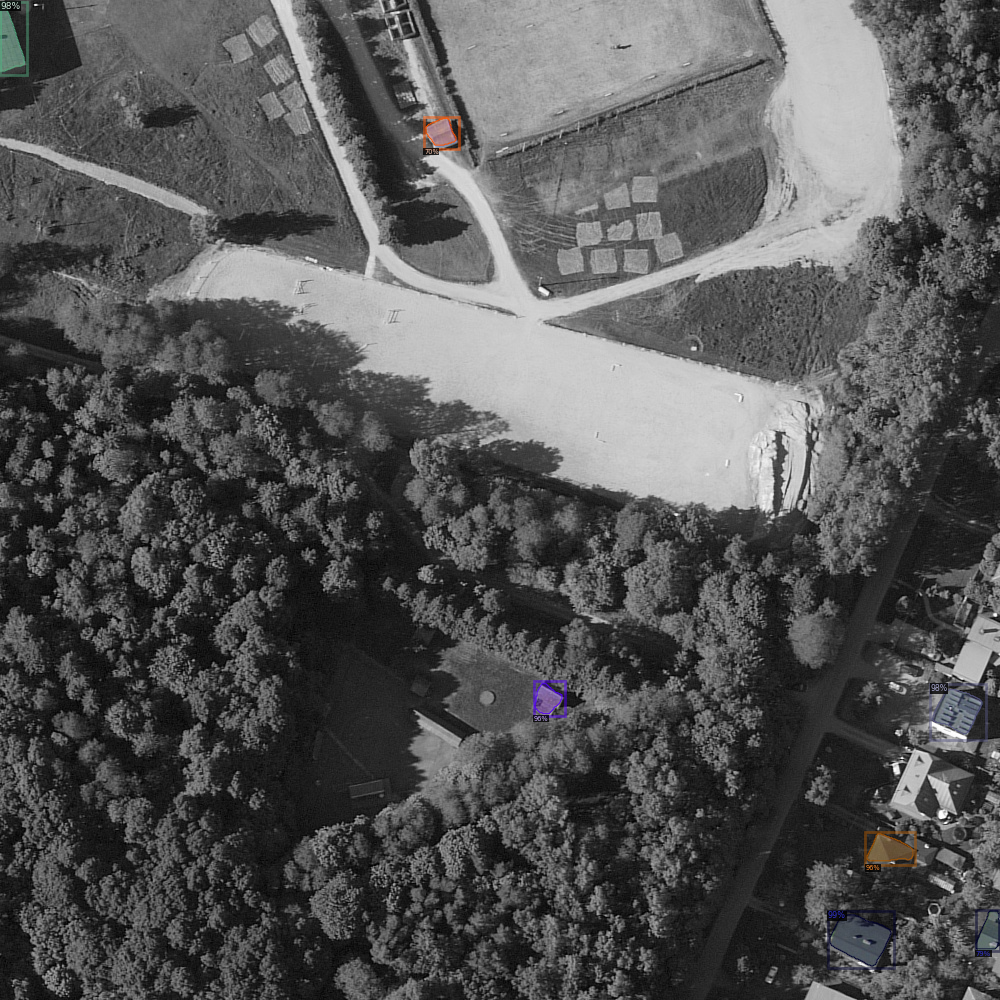

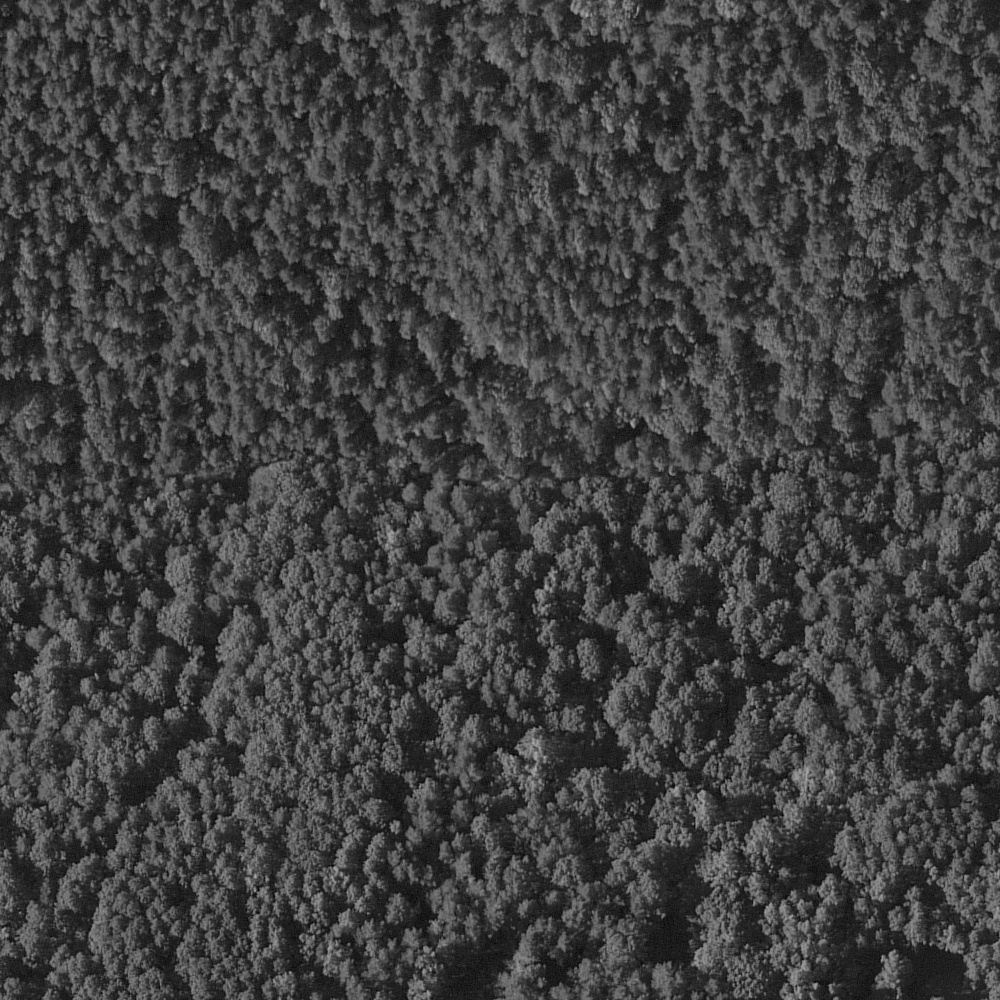

In [45]:

#cut out some random pieces and try to detect buildings
for _ in range(0,10):
  y = random.randint(0,19)
  x = random.randint(0,19)
  img_sub = img[(y*1000):(y*1000 + 1000), (x*1000):(x*1000 + 1000)]
  outputs = predictor(img_sub)
  v = Visualizer(img_sub[:, :, ::-1],
                  metadata=building_metadata,
                  scale=1.0,
                  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
  )
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::-1])